Spike Challenge by Rodrigo Toledo

Comentarios generales:
* El aproach tomado no es un analisis exhaustivo ni extrae todo lo que se podria desde la data provista
* Las visualizaciones tienen espacio para mejorar con el fin de ser compartidas, el objetivo de este documento es mostrar de la forma mas sencilla el objetivo del desafio. Dependiendo de lo que se quiera lograr utilizaria un programa externo para compartir resutados finales (Tableau si la audiencia es menos tecnica).
* La eficiencia y elegancia en general del codigo tiene espacio para mejorar


# 1. Datos: Precipitaciones, Indicadores Económicos Banco Central


In [1]:
import pandas as pd
import numpy as np

In [2]:
#get data from github

url = 'https://raw.githubusercontent.com/SpikeLab-CL/desafio_spike_precios/main/precipitaciones.csv'
prep_df = pd.read_csv(url)


url = 'https://raw.githubusercontent.com/SpikeLab-CL/desafio_spike_precios/main/banco_central.csv'
bc_df = pd.read_csv(url)

In [3]:
prep_df

,date,Coquimbo,Valparaiso,Metropolitana_de_Santiago,Libertador_Gral__Bernardo_O_Higgins,Maule,Biobio,La_Araucania,Los_Rios
0,1989-02-01,0.719033,0.117045,0.028272,0.000000,0.724667,9.172945,22.595834,52.268010
1,1998-10-01,0.065216,0.000000,0.011493,0.000000,0.008968,2.089674,14.702087,45.142041
2,2001-02-01,2.030026,0.047987,0.002634,0.000000,0.032163,10.768351,29.465057,65.571098
3,2008-11-01,0.622784,0.000000,0.015872,0.000000,1.734168,25.083557,64.901645,113.093488
4,2009-04-01,0.008065,0.000000,0.009396,0.000000,12.080715,56.233424,96.364235,155.622235
...,...,...,...,...,...,...,...,...,...
491,1988-10-01,0.000000,0.019886,4.621711,8.260992,27.616980,69.572460,133.732635,181.879767
492,2019-08-01,0.000000,0.430990,4.509748,9.900806,49.285557,108.404827,155.448370,233.621020
493,2015-06-01,0.000000,0.325714,4.888708,33.152636,117.695499,255.274275,343.280205,386.836253
494,2016-09-01,0.000000,0.035860,1.066980,3.090961,18.736997,45.646802,74.499307,119.114419


In [4]:
bc_df

,Periodo,Imacec_empalmado,Imacec_produccion_de_bienes,Imacec_minero,Imacec_industria,Imacec_resto_de_bienes,Imacec_comercio,Imacec_servicios,Imacec_a_costo_de_factores,Imacec_no_minero,PIB_Agropecuario_silvicola,PIB_Pesca,PIB_Mineria,PIB_Mineria_del_cobre,PIB_Otras_actividades_mineras,PIB_Industria_Manufacturera,PIB_Alimentos,PIB_Bebidas_y_tabaco,PIB_Textil,PIB_Maderas_y_muebles,PIB_Celulosa,PIB_Refinacion_de_petroleo,PIB_Quimica,PIB_Minerales_no_metalicos_y_metalica_basica,PIB_Productos_metalicos,PIB_Electricidad,PIB_Construccion,PIB_Comercio,PIB_Restaurantes_y_hoteles,PIB_Transporte,PIB_Comunicaciones,PIB_Servicios_financieros,PIB_Servicios_empresariales,PIB_Servicios_de_vivienda,PIB_Servicios_personales,PIB_Administracion_publica,PIB_a_costo_de_factores,Impuesto_al_valor_agregado,Derechos_de_Importacion,PIB,...,Precio_del_gas_natural_dolaresmillon_de_unidades_termicas_britanicas,Precio_del_petroleo_Brent_dolaresbarril,Precio_del_kerosene_dolaresm3,Precio_del_petroleo_WTI_dolaresbarril,Precio_del_propano_centavos_de_dolargalon_DTN,Tipo_de_cambio_del_dolar_observado_diario,Ocupados,Ocupacion_en_Agricultura_INE,Ocupacion_en_Explotacion_de_minas_y_canteras_INE,Ocupacion_en_Industrias_manufactureras_INE,Ocupacion_en_Suministro_de_electricidad_INE,Ocupacion_en_Actividades_de_servicios_administrativos_y_de_apoyo_INE,Ocupacion_en_Actividades_profesionales_INE,Ocupacion_en_Actividades_inmobiliarias_INE,Ocupacion_en_Actividades_financieras_y_de_seguros_INE,Ocupacion_en_Informacion_y_comunicaciones_INE,Ocupacion_en_Transporte_y_almacenamiento_INE,Ocupacion_en_Actividades_de_alojamiento_y_de_servicio_de_comidas_INE,Ocupacion_en_Construccion_INE,Ocupacion_en_Comercio_INE,Ocupacion_en_Suministro_de_agua_evacuacion_de_aguas_residuales_INE,Ocupacion_en_Administracion_publica_y_defensa_INE,Ocupacion_en_Enseanza_INE,Ocupacion_en_Actividades_de_atencion_de_la_salud_humana_y_de_asistencia_social_INE,Ocupacion_en_Actividades_artisticas_INE,Ocupacion_en_Otras_actividades_de_servicios_INE,Ocupacion_en_Actividades_de_los_hogares_como_empleadores_INE,Ocupacion_en_Actividades_de_organizaciones_y_organos_extraterritoriales_INE,No_sabe__No_responde_Miles_de_personas,Tipo_de_cambio_nominal_multilateral___TCM,Indice_de_tipo_de_cambio_real___TCR_promedio_1986_100,Indice_de_produccion_industrial,Indice_de_produccion_industrial__mineria,Indice_de_produccion_industrial_electricidad__gas_y_agua,Indice_de_produccion_industrial__manufacturera,Generacion_de_energia_electrica_CDEC_GWh,Indice_de_ventas_comercio_real_IVCM,Indice_de_ventas_comercio_real_no_durables_IVCM,Indice_de_ventas_comercio_real_durables_IVCM,Ventas_autos_nuevos
0,2013-03-01 00:00:00 UTC,102.796.218,10.546.824,978.554.365,102.297.537,114.994.919,110.729.395,100.064.328,103.163.651,103.405.852,579.846.819,570.624.122,123.491.343,110.356.254,131.350.889,130.648.285,367.818.436,162.692.807,330.305.467,643.366.109,974.948.182,103.469.519,184.460.073,807.709.837,212.409.058,301.314.934,710.242.818,115.489.064,202.838.669,546.694.889,337.915.263,5.691.837,11.393.886,793.471.519,140.103.913,512.994.015,108.482.797,896.688.023,659.936.009,118.109.613,...,3.8117,109.24,76.520.246,92.91,89.171,472.484,799.068.585,798.092.771,258.428.756,901.504.814,360.108.494,18.951.548,229.653.619,547.033.124,19.153.327,155.736.824,498.854.717,341.857.582,682.423.108,151.916.628,349.444.258,445.435.266,587.837.412,362.517.856,82.567.788,201.875.908,416.124.956,190.085.519,NaN,93.621,865.903.468,102.761.705,98.915.705,NaN,108.387.837,580.480.672,NaN,NaN,NaN,28577.0
1,2013-04-01 00:00:00 UTC,101.664.842,999.272.757,927.333.293,104.485.589,102.199.311,106.098.291,102.600.107,101.937.319,102.766.884,374.895.706,606.504.665,11.702.736,10.358.806,134.393.001,133.442.735,38.211.344,188.189.562,380.345.362,684.106.836,945.996.965,824.530.386,172.638.981,831.959.074,224.791.502,280.438.294,749.055.837,110.658.893,209.310.713,544.306.818,348.801.015,565.071.466,121.229.491,80.455.108,144.685.333,511.803.995,107.193.235,901.755.

# 2. Análisis de datos. Creación de variables

In [5]:
#!pip install dataprep
from dataprep.eda import create_report

NumExpr defaulting to 2 threads.


DataPrep Report
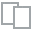
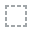
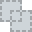
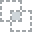
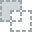
...
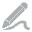
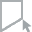
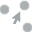
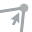
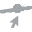

In [6]:
#EDA precipitaciones.csv
create_report(prep_df)

Sin datos faltantes. Sin duplicados.

Como es de esperar, las precipitaciones en las regiones del norte son menores en las regiones de Chile hacia el norte y aumnetan (em promedio) hacia el sur. Sesgo hacia menores precipitaciones en regiones del norte (ver histogramas)

Regiones cercanas geograficamente parecen estar corrlacionadas entre si (ver taba de correlaciones)

Posible precencia de outlyers en meses que han sido particularmente lluviosos en regiones del norte, ya que valores maximos son mayores a las de algunas regiones del sur. Por ejemplo el registro maximo en el Maule es de 759mm y en el Biobio de 702mm.

DataPrep Report
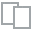
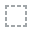
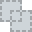
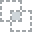
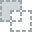
...
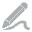
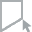
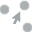
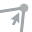
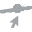

In [7]:
#limpiar data
bc_df_clean=bc_df.copy()
bc_df_clean=bc_df_clean.replace({"a": np.NaN}) #eliminar valores extranos
bc_df_clean.drop_duplicates(subset ="Periodo", keep = "first", inplace = True) #eliminar filas duplicadas, Agosto 2018 y 2019
bc_df_clean[bc_df_clean['Periodo']=='2020-13-01 00:00:00 UTC']


create_report(bc_df_clean.iloc[:, 0:9]) #Solo para variables del IMACEC como ejemplo para simplificar computacion

Data de IMACEC comienza a en 1996 en el dataset.

Data duplicada en Agosto 2018 y denuevo en Agosto 20119, removida.

Valores extranos ingresados 'aleatoreamente' con la letra a, cambiados a NaN.

Periodo esta ingresada como vatiable categorica, necesita ser cambiada a fecha para mayor flexibilidad.

Algunas columnas parecen utilizar el punto ('.') como separador de millones y otras como decimal. Es necesario tratar cada columna segun corresponda.

Por inspeccion la ultima fila parece ser un total o simplemente data errones (fecha con mes 13)

# 3. Visualización


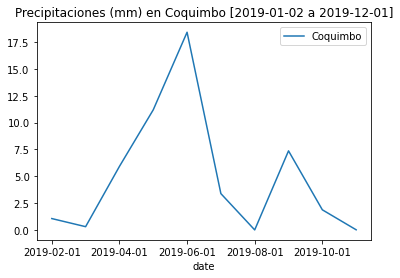

In [8]:
# función para graficar series históricas de precipitaciones para una region y rango de fechas determinado
# default: Metropolitana_de_Santiago para todas las las dechas disponibles
# funcion revisa si las fechas estan ingresadas en orden correcto
# funcion revisa si la region ingresada es valida 


def ts_plt(rgn='Metropolitana_de_Santiago',start_dt=min(prep_df['date']),end_dt=max(prep_df['date'])):
  if end_dt<start_dt:
    print('Fecha de inicio debe ser anterior a fecha de termino')
    #Idea: aun mejor seria identificar cual es la fecha menor y usar esa como pecha de inicio
    #Idea: revisar que el rango de fechas exista en la data y mostrar solo la data disponible
    #Idea: notificar cual es el rango de fecha disponible
  elif rgn not in prep_df.columns:
    print('Usar una region valida')
    #Idea: aun mejor seria mostrar en el mensaje de error las regiones validas
  else:
    df_plt= prep_df[(prep_df['date'] >= start_dt) & (prep_df['date'] < end_dt)].sort_values(by='date')
    df_plt.plot(x='date', y=rgn,title='Precipitaciones (mm) en ' + rgn + ' [' + start_dt +' a '+end_dt+']')


#ts_plt() # Default
ts_plt('Coquimbo','2019-01-02','2019-12-01') #ingresando argumentos
#ts_plt('Coquimbo','2020-01-01','2019-12-01') #ingresando argumentos erroneos, fecha
#ts_plt('Cokimbo','2019-01-01','2019-12-01') #ingresando argumentos erroneos, region

#Idea: Esteticas del grafico pueden ser mejores, acomodandose al la amplitud del rango de fechas

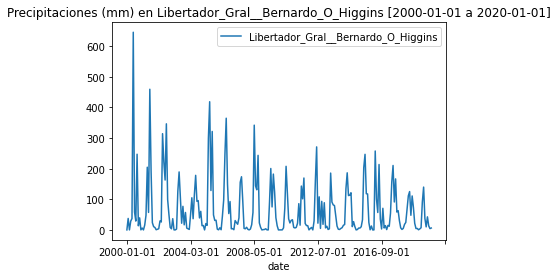

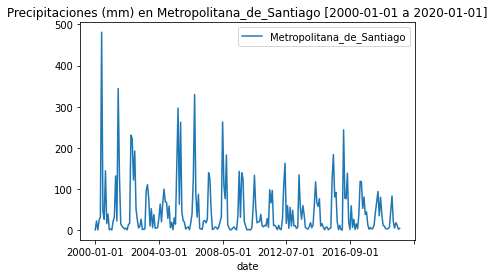

In [9]:
ts_plt('Libertador_Gral__Bernardo_O_Higgins', '2000-01-01', '2020-01-01' ) # Región Libertador General Bernardo O'Higgins
ts_plt('Metropolitana_de_Santiago', '2000-01-01', '2020-01-01' ) # Region Metropolitana
#Idea: usar distintos colores para las temporadas secas y lluviosas
#Idea: seria mejor para comparar mostrar en un mismo grafico ambas series.

Los graficos muestran la estacionalidad de los meses secos y lluviosos en las regiones Metropolitana y O'Higgins.

Parece haber una tendencia a la baja en la cantidad de mm de agua en las estaciones de lluvia, esta tendecia es mas clara en la region de O'Higgins.

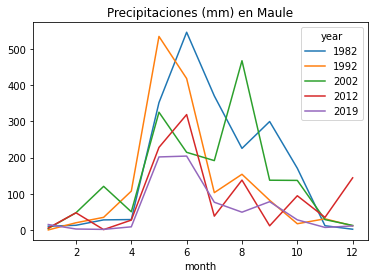

In [10]:
# función para graficar series de precipitaciones mensuales para una region comparando anio a anio
# default: Metropolitana_de_Santiago para 1998 y 2001
# funcion revisa si la region ingresada es valida 

def year_plt(rgn='Metropolitana_de_Santiago', yr=[1998,2001]):
  if rgn not in prep_df.columns:
    print('Usar una region valida')
  else:
    prep_df['year']=pd.DatetimeIndex(prep_df['date']).year
    prep_df['month']=pd.DatetimeIndex(prep_df['date']).month 

    df_plt= prep_df[prep_df['year'].isin(yr)].sort_values(by='date') #filtrar fechas
    pv = pd.pivot_table(df_plt, index=df_plt['month'], columns=df_plt['year'], values=rgn, aggfunc='sum') #pivotear mes/ano
    
    pv.plot(title='Precipitaciones (mm) en ' + rgn) #plot

year_plt('Maule',[1982, 1992, 2002, 2012 , 2019])

#Ideas: 
# Se puede modificar el eje horizontal para que muestre el mes (en palabra), en vez del numero
# Se puede revisar que los anios ingresados son validos
# Se puede modificar la legenda para que este sobre la serie para facilitar interpretacion

Los meses lluviosos parecen comenzar en Abril en la region del Maule, sin embargo a lo largo de los anos, el periodo humedo comienza a terminar antes (en Juilo de los anios mas recientes comparado con Noviembre de 1982). La excepcion es en 2002 cuando Agosto es particularmente lluviso.

Mas exploracion de la data es necesaria para confirmar estas observaciones extraidas de comparar solo 5 anios.

Para visualizar la data del PIB se debe construir una funcion similar a la primera de precipitaciones pero con una lista para las 2 metricas deceadas y plotear en el mismo grafico. Sin embargo se debe primero limpiar la data del archivo del banco central por los detalles encontrados durante el proceso de EDA.

# 4. Tratamiento y creación de variables

Para la creacion de un modelo las variables independiente deben estar preferentemente poco relacionadas entre si para evitar problemas de autocorrelacion (que distintos modelos pueden o no manejar de mejor manera). 
Es decir, buscar variables que no aporten 'la misma' infomacion a la prediccion. De esta forma se evita un potencial modelo que generalize de forma pobre.

Como analisis exploratorio seria bueno explorar la correlacion de las distintas series de tiempo independientes contra la el precio de la leche (dependiente) para considerar 'a priori' alguna correlacion (deseada).

Sin embargo, la auscencia de correlacion (lineal) no necesariamente indica la inieccistencia de un modelo satisfactorio.







In [11]:
url = 'https://raw.githubusercontent.com/SpikeLab-CL/desafio_spike_precios/main/precio_leche.csv'
leche_df = pd.read_csv(url)
leche_df

,Anio,Mes,Precio_leche
0,1979,Ene,3.85
1,1979,Feb,4.58
2,1979,Mar,5.18
3,1979,Abr,6.06
4,1979,May,7.25
...,...,...,...
501,2020,Oct,274.32
502,2020,Nov,288.09
503,2020,Dic,287.29
504,2021,Ene,287.60


In [12]:
# Transformanto el formato de fecha en archivo precio de leche
m = {
"Ene":1,
"Feb":2,
"Mar":3,
"Abr":4,
"May":5,
"Jun":6,
"Jul":7,
"Ago":8,
"Sep":9,
"Oct":10,
"Nov":11,
"Dic":12
}

df=leche_df.replace({"Mes": m}) # convierte a mes numnero
df['dia']='1' #agrega variable dummy para el dia

#Agrega fecha
df["Date"] = pd.to_datetime(df["Anio"].astype(str) + "/" + df["Mes"].astype(str) + "/" + df["dia"].astype(str))
df["Date"].dtypes

dtype('<M8[ns]')

In [13]:
#Merge
df_merge = pd.merge(df[['Date', 'Anio', 'Mes','Precio_leche']], prep_df,
                    how='left',
                    left_on=['Date'],
                    right_on=pd.to_datetime(prep_df['date']))

df_merge.sort_values(by='date')

,Date,Anio,Mes,Precio_leche,date,Coquimbo,Valparaiso,Metropolitana_de_Santiago,Libertador_Gral__Bernardo_O_Higgins,Maule,Biobio,La_Araucania,Los_Rios,year,month
0,1979-01-01,1979,1,3.85,1979-01-01,2.641948,0.587062,2.447114,1.608992,3.736215,17.859634,25.212940,45.596447,1979.0,1.0
1,1979-02-01,1979,2,4.58,1979-02-01,1.179804,2.432192,3.997852,4.346310,16.347637,17.680612,18.085072,34.075039,1979.0,2.0
2,1979-03-01,1979,3,5.18,1979-03-01,0.255490,0.020601,0.000000,0.055488,0.545324,14.435698,28.696504,66.232248,1979.0,3.0
3,1979-04-01,1979,4,6.06,1979-04-01,10.173699,11.745779,13.722349,12.989194,21.880607,39.136483,43.617921,73.548127,1979.0,4.0
4,1979-05-01,1979,5,7.25,1979-05-01,1.039098,18.609286,50.187148,104.451550,143.914334,219.729235,279.409718,438.005116,1979.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,2020-10-01,2020,10,274.32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
502,2020-11-01,2020,11,288.09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
503,2020-12-01,2020,12,287.29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
504,2021-01-01,2021,1,287.60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
df_merge['trimestre'] = df['Date'].dt.quarter # agregar trimestre
df_merge['Precio_leche_lag1'] = df_merge['Precio_leche'].shift(1) #lag de 1 mes
df_merge['Precio_leche_lag3'] = df_merge['Precio_leche'].shift(3) #lag de 3 meses
df_merge['Precio_leche_lag12'] = df_merge['Precio_leche'].shift(12) #lag de 12 meses
df_merge['Los_Rios_cum_sum'] = df_merge['Los_Rios'].cumsum() # precipitacion acummulada en los rios
df_merge['Los_Rios_cum_sum_y'] = df_merge.groupby(['Anio'])['Los_Rios'].cumsum() #precipitacin acumulada en el anio
df_merge['Los_Rios_cum_sum_tri'] = df_merge.groupby(['Anio','trimestre'])['Los_Rios'].cumsum() #precipitacin acumulada en el trimestre


df_merge
# Los Rios, de entre las regiones con data es la que mayor productora de leche, posiblemente con mayor impacto, serio interesante tener 
# la data de Los Lagos que representa 50% de la produccion del pais 
# Fuente: https://www.fedeleche.cl/ww4/index.php/noticias/todas-las-noticias/5959-resultados-produccion-de-leche-por-region-en-2020

# Se podrian generara metricas equivalente para las otras regiones

,Date,Anio,Mes,Precio_leche,date,Coquimbo,Valparaiso,Metropolitana_de_Santiago,Libertador_Gral__Bernardo_O_Higgins,Maule,Biobio,La_Araucania,Los_Rios,year,month,trimestre,Precio_leche_lag1,Precio_leche_lag3,Precio_leche_lag12,Los_Rios_cum_sum,Los_Rios_cum_sum_y,Los_Rios_cum_sum_tri
0,1979-01-01,1979,1,3.85,1979-01-01,2.641948,0.587062,2.447114,1.608992,3.736215,17.859634,25.212940,45.596447,1979.0,1.0,1,NaN,NaN,NaN,45.596447,45.596447,45.596447
1,1979-02-01,1979,2,4.58,1979-02-01,1.179804,2.432192,3.997852,4.346310,16.347637,17.680612,18.085072,34.075039,1979.0,2.0,1,3.85,NaN,NaN,79.671486,79.671486,79.671486
2,1979-03-01,1979,3,5.18,1979-03-01,0.255490,0.020601,0.000000,0.055488,0.545324,14.435698,28.696504,66.232248,1979.0,3.0,1,4.58,NaN,NaN,145.903734,145.903734,145.903734
3,1979-04-01,1979,4,6.06,1979-04-01,10.173699,11.745779,13.722349,12.989194,21.880607,39.136483,43.617921,73.548127,1979.0,4.0,2,5.18,3.85,NaN,219.451860,219.451860,73.548127
4,1979-05-01,1979,5,7.25,1979-05-01,1.039098,18.609286,50.187148,104.451550,143.914334,219.729235,279.409718,438.005116,1979.0,5.0,2,6.06,4.58,NaN,657.456976,657.456976,511.553243
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,2020-10-01,2020,10,274.32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,278.99,313.30,243.44,NaN,NaN,NaN
502,2020-11-01,2020,11,288.09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,274.32,309.44,251.22,NaN,NaN,NaN
503,2020-12-01,2020,12,287.29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,288.09,278.99,253.86,NaN,NaN,NaN
504,2021-01-01,2021,1,287.60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,287.29,274.32,254.10,NaN,NaN,NaN


# 5. Modelo


Dado que, por el momento no alcanzare a construir un modelo con rigurosidad, propongo pasos que siguiria a modo de general:

- construir cross-validation sets
- contdefinir multiples modelos con distintas variables predictoras
  - primedios modiles
  - volatilidad
  - lags
  - data externa
  - enstacionalidades
  - varios...
- definir multiples tipos de modelos
- computar los modelos combinando los puntos anterirores
- Evaluar el mejor modelo

A considerar:
- overfiting
- outocorrelacion en la variables predictoras
- un modelo con menos predictores es mejor que uno muy complejo con similar performance


Sobre datos adicionales:

Seria interesante conocer tener los datos para la region de Los Lagos que es la mayor productora de leche en Chile.

Ademas informacion sobre el precio de la carne de vacuno, seguramente con variaciones con correlacion inversa a los del precio de la leche. En anios con precio de carne alto los recursos dedicados al ganado son utilizados para razas de carne, mas que de leche.

Informacion sobre costos de industrias de que suministran a la industria lechera. Si suben los costos apriori subiria el costo de la leche.


Sobre aplicaciones de un modelo similar:

Un modelo con series de tiempo tiene aplicaciones en variados campos, desde predicciones busatiles hasta demanda de insumos. En particular para el precio de la leche tiene particular importacia para los prodctores ay que pueden estimar el retorno y con ello la inversion en produccion para la temporada. Adeamas, a nivel pais se pueden aplicar politicas que insentiven o ayuden a productores si se conoce con antelacion que una temporada sera articularmente dificil debido a los condiciones (como la precipitacion en el  anio anterior)


Con respecto al cambio climatico, creo que hay dos aspectos generales para ulilizar esta data (que nos habla del valor al momento de interpretar resultados). Primero, se puede crear el argumento que producto del cambio climatico, el precio de la leche se ve afectado ya que menos epocas de lluvia (o lo que descubra el modelo) hacen mas dificil su produccion, por lo tanto se deben tomar medidas para mitigar los efectos del cambio climatico. Por otro lado, se podria crear el argumento contrario, ya que el ganado al ser uno de lo mayores productores de CO2, y generadores del cambio climatico (con alta huella de carbono), estan afectando variables como la precipitacion, para lo cual seria interesante hacer el ejercicio inverso de predecir las precipitaciones basadas en a produccion, demanda y precio de la leche.